In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import os

In [2]:
os.listdir()
os.chdir(r"C:\Users\RYZEN\logistic-optimization")
os.listdir()


['.dvc',
 '.dvcignore',
 '.git',
 'data',
 'heatmap_vs_time.html',
 'notebooks',
 'README.md',
 'screenshots',
 'scripts',
 'tests']

In [3]:
trips_df= pd.read_csv('data/nb.csv')

In [4]:
trips_df.head()

,trip_id,trip_origin,trip_destination,trip_start_time,trip_end_time
0,391996,"6.508813001668548,3.37740316890347","6.650969799999999,3.3450307",7/1/2021 7:28,7/1/2021 7:29
1,391997,"6.4316714,3.4555375","6.4280814653326,3.4721885847586",7/1/2021 6:38,7/1/2021 7:07
2,391998,"6.631679399999999,3.3388976","6.508324099999999,3.3590397",7/1/2021 6:21,7/1/2021 7:02
3,391999,"6.572757200000001,3.3677082","6.584881099999999,3.3614073",7/1/2021 7:16,7/1/2021 7:29
4,392001,"6.6010417,3.2766339","6.4501069,3.3916154",7/1/2021 9:30,7/1/2021 9:34


In [5]:
trips_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 536020 entries, 0 to 536019
Data columns (total 5 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   trip_id           536020 non-null  int64 
 1   trip_origin       536020 non-null  object
 2   trip_destination  536020 non-null  object
 3   trip_start_time   534369 non-null  object
 4   trip_end_time     536019 non-null  object
dtypes: int64(1), object(4)
memory usage: 20.4+ MB


In [6]:
# checking missing value
trips_df.isna().sum()

trip_id                0
trip_origin            0
trip_destination       0
trip_start_time     1651
trip_end_time          1
dtype: int64

## VISUALIZE TRIPS

In [7]:
import datashader as ds
import datashader.transfer_functions as dtf
from datashader.colors import colormap_select as cm, inferno, viridis
from datashader.utils import lnglat_to_meters

import matplotlib as mpl
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd
import seaborn as sns

from IPython.display import display, HTML
from matplotlib.colors import LinearSegmentedColormap

# Datashader helper function:
def bg(img): return dtf.set_background(img, "black")

%matplotlib inline
mpl.rcParams['figure.dpi'] = 130

In [8]:
# def convert_to_datetime(self, df:pd.DataFrame)->pd.DataFrame
# convert column to datetime
trips_df['trip_start_time']=pd.to_datetime(trips_df['trip_start_time'])        
trips_df['trip_end_time']=pd.to_datetime(trips_df['trip_end_time'])        


In [9]:
hourly_counts = trips_df.set_index('trip_start_time').resample('1h').size().reset_index(name='trips')
hourly_counts['date'] = hourly_counts.trip_start_time.dt.strftime("%b %d %Y")
hourly_counts['hour'] = hourly_counts.trip_start_time.dt.hour
hourly_counts['DoW'] = hourly_counts.trip_start_time.dt.dayofweek
hourly_counts.head()

,trip_start_time,trips,date,hour,DoW
0,2021-07-01 06:00:00,6,Jul 01 2021,6,3
1,2021-07-01 07:00:00,37,Jul 01 2021,7,3
2,2021-07-01 08:00:00,128,Jul 01 2021,8,3
3,2021-07-01 09:00:00,233,Jul 01 2021,9,3
4,2021-07-01 10:00:00,297,Jul 01 2021,10,3


c:\Users\RYZEN\anaconda3\envs\py37\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The tsplot function is deprecated and will be removed or replaced (in a substantially altered version) in a future release.
  warnings.warn(msg, UserWarning)


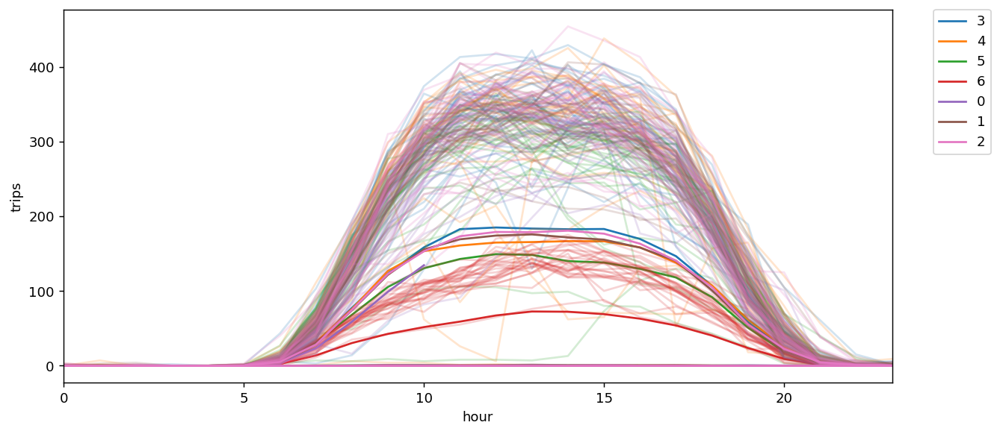

In [10]:
plt.figure(figsize=(11, 5))
sns.tsplot(time="hour", value="trips", unit="date", condition='DoW', data=hourly_counts, err_style="unit_traces", )
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.);

# USE DIFF COLOR,

How Most trips always start from the 6th hour of the day and peaks at midday or noon and the trips start reducing until 8pm in the evening Nigerian time.

In [11]:
#splitting cordinates column from x,y to x ad y
trips_df['trip_origin_lat'] = trips_df['trip_origin'].apply(lambda x: str(x).split(',')[0])
trips_df['trip_origin_lng'] = trips_df['trip_origin'].apply(lambda x: str(x).split(',')[1])

In [12]:
#splitting cordinates column from x,y to x ad y
trips_df['trip_destination_lat'] = trips_df['trip_destination'].apply(lambda x: str(x).split(',')[0])
trips_df['trip_destination_lng'] = trips_df['trip_destination'].apply(lambda x: str(x).split(',')[1])

In [13]:
trips_df.head()

,trip_id,trip_origin,trip_destination,trip_start_time,trip_end_time,trip_origin_lat,trip_origin_lng,trip_destination_lat,trip_destination_lng
0,391996,"6.508813001668548,3.37740316890347","6.650969799999999,3.3450307",2021-07-01 07:28:00,2021-07-01 07:29:00,6.508813001668548,3.37740316890347,6.650969799999999,3.3450307
1,391997,"6.4316714,3.4555375","6.4280814653326,3.4721885847586",2021-07-01 06:38:00,2021-07-01 07:07:00,6.4316714,3.4555375,6.4280814653326,3.4721885847586
2,391998,"6.631679399999999,3.3388976","6.508324099999999,3.3590397",2021-07-01 06:21:00,2021-07-01 07:02:00,6.631679399999999,3.3388976,6.508324099999999,3.3590397
3,391999,"6.572757200000001,3.3677082","6.584881099999999,3.3614073",2021-07-01 07:16:00,2021-07-01 07:29:00,6.572757200000001,3.3677082,6.584881099999999,3.3614073
4,392001,"6.6010417,3.2766339","6.4501069,3.3916154",2021-07-01 09:30:00,2021-07-01 09:34:00,6.6010417,3.2766339,6.4501069,3.3916154


In [14]:
trips_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 536020 entries, 0 to 536019
Data columns (total 9 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   trip_id               536020 non-null  int64         
 1   trip_origin           536020 non-null  object        
 2   trip_destination      536020 non-null  object        
 3   trip_start_time       534369 non-null  datetime64[ns]
 4   trip_end_time         536019 non-null  datetime64[ns]
 5   trip_origin_lat       536020 non-null  object        
 6   trip_origin_lng       536020 non-null  object        
 7   trip_destination_lat  536020 non-null  object        
 8   trip_destination_lng  536020 non-null  object        
dtypes: datetime64[ns](2), int64(1), object(6)
memory usage: 36.8+ MB


In [15]:
trips_df.to_csv('data/extract_trips.csv', index=False)


**Pickup and dropoff locations distribution**

- blue : pickup locations
- yellow : dropoff locations


In [16]:
import datashader as ds
import pandas as pd
import colorcet as cc
import holoviews as hv
from holoviews.element.tiles import EsriImagery
from holoviews.operation.datashader import datashade

## FOLIUM VISUALIZATION

Here we try to understand where most requests are, at what time? and where can you advise your driver to wait , because it's a hotspot, and at what time should they be at the hotspot?

In [17]:
import pandas as pd
import folium
from folium.plugins import HeatMap
from folium.plugins import HeatMapWithTime

In [18]:
def generateBaseMap(default_location=[6.45407,3.39467], default_zoom_start=11):
    """
    location: Define the default location to zoom at when rendering the map
    zoom_start: The zoom level that the map will default to when rendering the map
    control_scale: Shows the map scale for a given zoom level
    """
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map

In [19]:
base_map = generateBaseMap()
base_map

In [49]:
#Extract datetime
trips_df.trip_start_time = pd.to_datetime(trips_df.trip_start_time, format='%Y-%m-%d %H:%M:%S')
trips_df['month'] = trips_df.trip_start_time.apply(lambda x: x.month)
trips_df['week'] = trips_df.trip_start_time.apply(lambda x: x.week)
trips_df['day'] = trips_df.trip_start_time.apply(lambda x: x.day)
trips_df['hour'] = trips_df.trip_start_time.apply(lambda x: x.hour)
trips_df.head()

,trip_id,trip_origin,trip_destination,trip_start_time,trip_end_time,trip_origin_lat,trip_origin_lng,trip_destination_lat,trip_destination_lng,month,week,day,hour,hdist,log_hdist
0,391996,"6.508813001668548,3.37740316890347","6.650969799999999,3.3450307",2021-07-01 07:28:00,2021-07-01 07:29:00,1.335746e+05,4.185288e+10,NaN,4.145172e+10,7.0,26.0,1.0,7.0,5.861564e+06,15.583927
1,391997,"6.4316714,3.4555375","6.4280814653326,3.4721885847586",2021-07-01 06:38:00,2021-07-01 07:07:00,-1.349686e+05,4.282112e+10,-5.368732e+06,4.302746e+10,7.0,26.0,1.0,6.0,6.853225e+06,15.740230
2,391998,"6.631679399999999,3.3388976","6.508324099999999,3.3590397",2021-07-01 06:21:00,2021-07-01 07:02:00,3.056999e+07,4.137572e+10,-7.090542e+06,4.162532e+10,7.0,26.0,1.0,6.0,1.371815e+07,16.434231
3,391999,"6.572757200000001,3.3677082","6.584881099999999,3.3614073",2021-07-01 07:16:00,2021-07-01 07:29:00,-4.019165e+06,4.173274e+10,NaN,4.165466e+10,7.0,26.0,1.0,7.0,6.970751e+06,15.757234
4,392001,"6.6010417,3.2766339","6.4501069,3.3916154",2021-07-01 09:30:00,2021-07-01 09:34:00,NaN,4.060414e+10,NaN,4.202900e+10,7.0,26.0,1.0,9.0,1.781835e+07,16.695739


In [21]:
# We will be using 2 months worth of data for this analysis.
df_copy = trips_df[trips_df.month>0].copy()
df_copy['count'] = 1

In [22]:
df_copy[['trip_origin_lat', 'trip_origin_lng', 'count']].groupby(['trip_origin_lat', 'trip_origin_lng']).sum().sort_values('count', ascending=False).head(10)

,,count
trip_origin_lat,trip_origin_lng,
6.6137933,3.357997,865
6.462727,3.55679,668
6.4293597,3.4334968,576
6.4286308,3.5155123,544
6.622069799999999,3.383825,538
6.4440858,3.5080498,537
6.4431192,3.4814372,534
6.5952581,3.3521434,522
6.452345299999999,3.527539,520


In [23]:
# From the dataframe above, it can be clearly seen that using tables to try to understand spatial data is an impossible task 
base_map = generateBaseMap()
HeatMap(data=df_copy[['trip_origin_lat', 'trip_origin_lng', 'count']].groupby(['trip_origin_lat', 'trip_origin_lng']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)


In [24]:
base_map

The heatmap above shows area where most requests are located, therefore shows where drivers need to be adviced to wait for requests.

In [25]:
#We aregoing to add markers to suggest potential locations so as to extract the locations and towns from the map.
base_map.add_child(folium.ClickForMarker(popup='Potential Location'))

Let's add a time factor, to map requests vs time.

In [26]:
df_hour_list = []
for hour in df_copy.hour.sort_values().unique():
    df_hour_list.append(df_copy.loc[df_copy.hour == hour, ['trip_origin_lat', 'trip_origin_lng', 'count']].groupby(['trip_origin_lat', 'trip_origin_lng']).sum().reset_index().values.tolist())


In [27]:
base_map = generateBaseMap(default_zoom_start=11)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map


In [28]:
base_map.save('heatmap_vs_time.html')


The animation above shows order requests in 24 hours vs location of requests. We ca get insights from this video, to advise the rider where to be at a specific time.

Reference; https://www.kaggle.com/code/faridrizqis/folium-for-map-visualization/notebook